In [1]:
#importing libraries
from __future__ import print_function
%matplotlib inline
import argparse
import os
import random
import torch 
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

#set random seed for reproducibility
manualseed = random.randint(1, 10000) 
print("Random Seed: ", manualseed)
random.seed(manualseed)
torch.manual_seed(manualseed)

Random Seed:  6513


In [2]:
    """
    Inputs:
    dataroot: path to dataset
    workers: number of worker threads for loading the data with the DataLoader
    batch_size: batch size for training.We are using batch size of 128
    image_size: the spatial size of the images. All images will be resized to 64x64 other we have to change the structure of the Discriminator and Generator.
    nc : number of color channels in the input images. For color images this is 3
    nz: size of the latent z vector
    ngf: size of feature maps in the generator
    ndf: size of feature maps in the discriminator
    num_epochs: number of training epochs to run.
    lr: learning rate for training.
    beta1: beta1 hyperparameter for Adam optimizer.
    ngpu: number of GPUs available. Use 0 for CPU mode.
    """
    #root directory for dataset
    data_root ='D:\CelebA\CelebA\Img\img_align_celeba_png.7z\img_align_celeba_png.7z'
    
    #number of workers for dataloader
    workers = 2
    
    #batch size during training
    batch_size = 128
    
    #spatial size of training images.
    image_size = 64
    
    #number of channels in the training images. For color images this is 3
    nc = 3
    
    #Size of z latent vector (i.e. size of generator input)
    nz = 100
    
    #Size of feature maps in generator
    ngf = 64
    
    #Size of feature maps in discriminator
    ndf = 64
    
    #Number of training epochs
    num_epochs = 40
    
    #learning rate for optimizers
    lr = 0.0002
    
    #Beta1 hyperparam for Adam optimizers
    beta1=0.5
    
    #Number of GPUs available. Use 0 for CPU mode.
    ngpu = 1
    
    

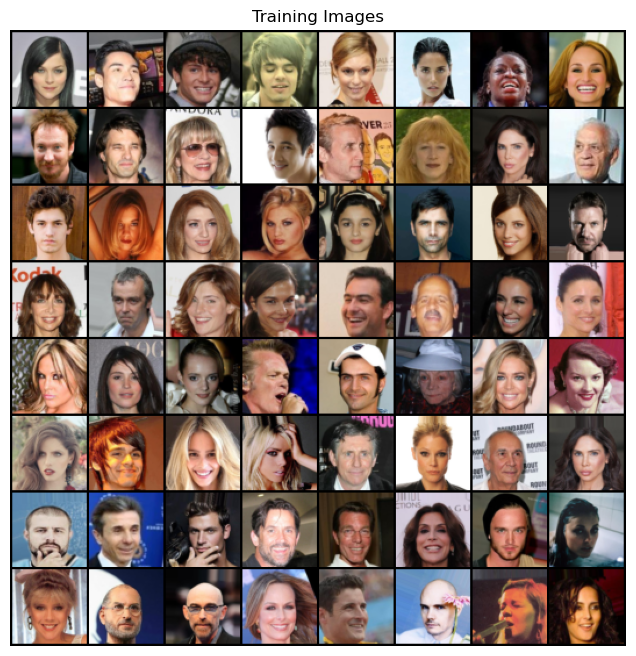

In [3]:
    """Data
    We are using the CelebA dataset.(here:http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) This dataset is famous for its diversity of faces.
    the directory structure is something like
    
    /path/to/celeba
    -> img_align_celeba
        -> 188242.jpg
        -> 173822.jpg
        -> 284702.jpg
        -> 537394.jpg
           ...
    """

#we create a function that loads the dataset

dataset = dset.ImageFolder(root=data_root,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                            ]))

#This is the loader that will feed the data to the dataloader

dataloader =  torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                          shuffle = True, num_workers = workers)

#device to use for training

device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

#plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [4]:
    """Weight initialization
    In our implementation of the DCGAN, the weights of the discriminator and generator are initialized by using He initialisation.
    The formula for He initialisation is:
    W = np.random.randn( *shape)*np.sqrt(2./(fan_in+fan_out))
    The weights_init function does this for each of the layers of the network.
    """
    #custom weights initialization called on netG(Generator network) and netD(Discriminator network)
    
    def weights_init(m):
        classname = m.__class__.__name__
        if classname.find('Conv') != -1:
            nn.init.normal_(m.weight.data, 0.0, 0.02)
        elif classname.find('BatchNorm') != -1:
            nn.init.normal_(m.weight.data, 1.0, 0.02)
            nn.init.constant_(m.bias.data, 0)
    

The architecture of the Generator: <img src = "https://pytorch.org/tutorials/_images/dcgan_generator.png">

In [5]:
    """Generator Code
     The generator is a convolutional neural network. It is defined as follows:
     The generator is made up of a series of convolutional transpose layers, followed by a series of fully connected layers, and finally a sigmoid activation at the end.
     The input to the generator is a noise vector. The output is an image. The output of the generator is fed back into the input of the generator to produce an image that is closer to the input.
    
    """
    #generator class
    
    class Generator(nn.Module):
        def __init__(self, ngpu):
            super(Generator, self).__init__()
            self.npgu = ngpu
            self.main = nn.Sequential(
                #input is Z, going into a convolution
                nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
                nn.BatchNorm2d(ngf * 8),
                nn.ReLU(True),
                #state size. (ngf*8) x 4 x 4
                nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
                nn.BatchNorm2d(ngf * 4),
                nn.ReLU(True),
                #state size (ngf*4) x 8 x 8
                nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
                nn.BatchNorm2d(ngf * 2),
                nn.ReLU(True),
                #state size (ngf*2) x 16 x 16
                nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
                nn.BatchNorm2d(ngf),
                nn.ReLU(True),
                #state size (ngf) x 32 x 32
                nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
                nn.Tanh()
                #state size (nc) x 64 x 64
            )
        def forward(self, input):
            return self.main(input)
        
                
    

In [6]:
#Create the generator
netG = Generator(ngpu).to(device)

#handling multi-gpu if desired
if(device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))
    
#apply the weights_init function to randomly initialize all weights
# to mean=0, stdev=0.2.

netG.apply(weights_init)

#printing the model

print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [7]:
    """Discriminator:
    A discriminator network is a convolutional neural network that takes an image as input and outputs a scalar probability that the input image is real.
    Here our Discriminator takes a 3x64x64 input image and processes it through 4 convolutional layers and 4 fully connected layers of Conv2d, BatchNorm2d, LeakyReLU and Sigmoid activation function.
    """
    #discriminator class
    
    class Discriminator(nn.Module):
        def __init__(self, ngpu):
            super(Discriminator, self).__init__()
            self.ngpu = ngpu
            self.main = nn.Sequential(
                #input is (nc) x 64 x 64
                nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
                nn.LeakyReLU(0.2, inplace=True),
                #state size (ndf) x 32 x 32
                nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
                nn.BatchNorm2d(ndf * 2),
                nn.LeakyReLU(0.2, inplace=True),
                #state size (ndf*2) x 16 x 16
                nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
                nn.BatchNorm2d(ndf * 4),
                nn.LeakyReLU(0.2, inplace=True),
                #state size (ndf*4) x 8 x 8
                nn.Conv2d(ndf*4, ndf*8, 4, 2, 1, bias=False),
                nn.BatchNorm2d(ndf*8),
                nn.LeakyReLU(0.2, inplace=True),
                #state size (ndf*8) x 4 x 4
                nn.Conv2d(ndf*8, 1, 4, 1, 0, bias=False),
                nn.Sigmoid()
            )
            
        def forward(self, input):
            return self.main(input)
                

In [8]:
#creating the discriminator
netD = Discriminator(ngpu).to(device)

#handling multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))
    
#apply the weights_init function to randomly initialize all weights
# to mean=0, stdev=0.2.
netD.apply(weights_init)

#printing the model
print(netD)


Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [9]:
"""Loss Functions and Optimizers
    The generator and the discriminator are defined as separate networks.
    We will use the Binary Cross Entropy loss function for both which is defined as:
    l(x, y) = - y * log(x) - (1 - y) * log(1 - x)
"""
#initializing the loss function
criterion = nn.BCELoss()

#creating a batch of latent vectors that we will use to generate images
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

#establishing convention for real and fake labels during training
real_label = 1. 
fake_label = 0.

#creating the optimizers for the generator and the discriminator
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))


In [10]:
"""Training the Models
    Training the GANs requires the following steps:
    Phase 1:
    Training the discriminator using a real image of the dataset as input
    wish to “update the discriminator by ascending its stochastic gradient”. Practically, we want to maximize log(D(x)) + log(1-D(G(z)))log(D(x))+log(1−D(G(z))). Due to the separate mini-batch suggestion from ganhacks, we will calculate this in two steps. 
    First, we will construct a batch of real samples from the training set, forward pass through DD, calculate the loss (log(D(x))log(D(x))), then calculate the gradients in a backward pass.
    Secondly, we will construct a batch of fake samples with the current generator, forward pass this batch through DD, calculate the loss (log(1-D(G(z)))log(1−D(G(z)))), and accumulate the gradients with a backward pass. 
    Now, with the gradients accumulated from both the all-real and all-fake batches, we call a step of the Discriminator’s optimizer.
    
    Phase 2:
    Training the generator using a fake image generated from the current generator as input.
    Wish to “update the discriminator by ascending its stochastic gradient”. 
    Practically, we want to maximize log(D(x)) + log(1-D(G(z)))log(D(x))+log(1−D(G(z))). 
    Due to the separate mini-batch suggestion from ganhacks, we will calculate this in two steps.
    First, we will construct a batch of real samples from the training set, forward pass through DD, calculate the loss (log(D(x))log(D(x))), then calculate the gradients in a backward pass. 
    Secondly, we will construct a batch of fake samples with the current generator, forward pass this batch through DD, 
    calculate the loss (log(1-D(G(z)))log(1−D(G(z)))), and accumulate the gradients with a backward pass. 
    Now, with the gradients accumulated from both the all-real and all-fake batches, we call a step of the Discriminator’s optimizer.
    Finally, we will report some statistics for this training epoch, we will push our fixed_noise batch through the generator
    and then start the next epoch.
    The training statistics reported are:
    1. Loss_D: The loss calculated using the all-real batch calulated as log(D(x)) + log(1-D(G(z)))log(1−D(G(z))).
    2. Loss_G: The loss calculated using the all-fake batch calculated as log(D(G(z)))
    3. D(x): The average output of the discriminator for the all-real batch.
    4. D(G(z)): The average output of the discriminator for the all-fake batch.
    """
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1
                         
                      

Starting Training Loop...
[0/4][0/1583]	Loss_D: 1.7015	Loss_G: 6.1328	D(x): 0.6744	D(G(z)): 0.6563 / 0.0036
[0/4][50/1583]	Loss_D: 0.0267	Loss_G: 23.6130	D(x): 0.9862	D(G(z)): 0.0000 / 0.0000
[0/4][100/1583]	Loss_D: 1.1244	Loss_G: 14.4713	D(x): 0.9406	D(G(z)): 0.4845 / 0.0001
[0/4][150/1583]	Loss_D: 1.3327	Loss_G: 8.3733	D(x): 0.9609	D(G(z)): 0.5655 / 0.0011
[0/4][200/1583]	Loss_D: 0.3626	Loss_G: 6.3984	D(x): 0.9147	D(G(z)): 0.2127 / 0.0027
[0/4][250/1583]	Loss_D: 0.5792	Loss_G: 4.2192	D(x): 0.7171	D(G(z)): 0.1180 / 0.0257
[0/4][300/1583]	Loss_D: 0.5151	Loss_G: 5.5242	D(x): 0.9481	D(G(z)): 0.3162 / 0.0106
[0/4][350/1583]	Loss_D: 0.7293	Loss_G: 4.7024	D(x): 0.9264	D(G(z)): 0.4173 / 0.0189
[0/4][400/1583]	Loss_D: 0.3890	Loss_G: 2.9836	D(x): 0.8157	D(G(z)): 0.1232 / 0.0724
[0/4][450/1583]	Loss_D: 0.6766	Loss_G: 3.3890	D(x): 0.7246	D(G(z)): 0.1300 / 0.0568
[0/4][500/1583]	Loss_D: 0.4302	Loss_G: 3.8035	D(x): 0.8509	D(G(z)): 0.1865 / 0.0380
[0/4][550/1583]	Loss_D: 0.3522	Loss_G: 5.4469	D(x):

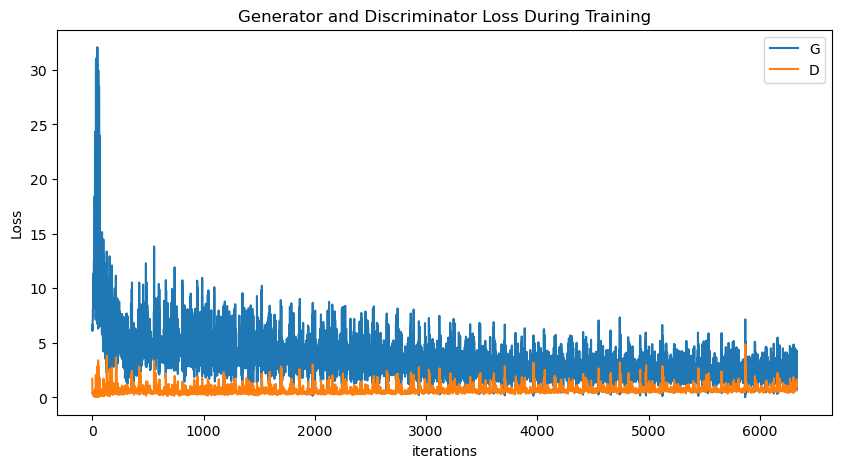

In [11]:
"""Results:
We plot three different results.First, we will see how D and G's losses changed during training. Second, we will visualize G's output
on the fixed_noise batch for every epochs. And third, we will look at a batch of real data next to a batch of fake data from G"""

#loss versus training iteration

plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

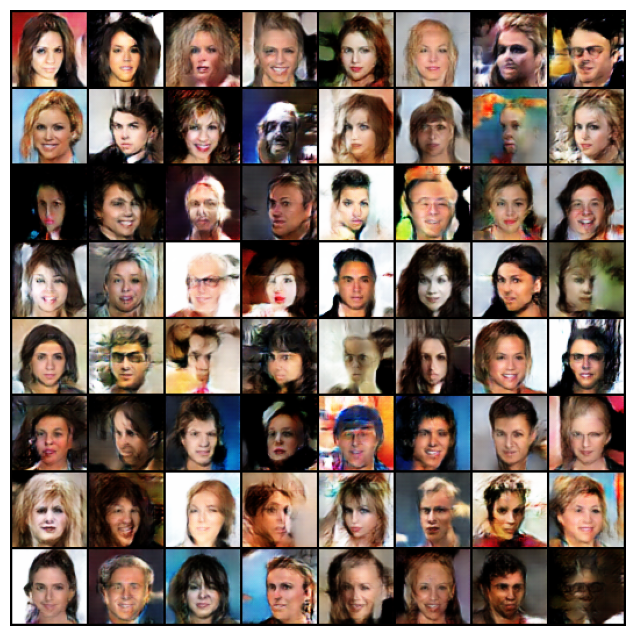

In [12]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

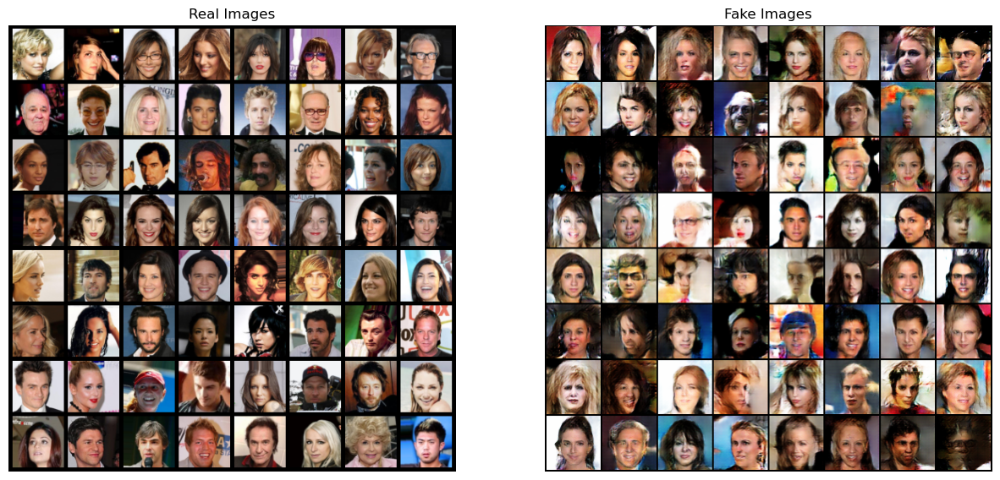

In [13]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()